<a href="https://colab.research.google.com/github/yowlshi/Dengue-Mosquito-Detection-System-Using-Audio-Analysis/blob/main/Dengue%20Mosquito%20Detection%20System%20Using%20Audio%20Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# THE PROBLEM

Dengue fever remains a significant public health issue in the Philippines, with over 208,000 cases reported as of September 2024, exacerbated by favorable breeding conditions from climate change.

[ABS-CBN NEWS](https://www.abs-cbn.com/lifestyle/health-wellness/2024/9/16/philippines-logs-208-000-dengue-cases-as-of-sept-2024-1231)


Research shows that the wingbeat frequency of Aedes aegypti, the primary dengue vector, typically ranges between 300–600 Hz, making this frequency band critical for distinguishing it from other insects and environmental sounds.

[Cator et al., 2009](https://pubmed.ncbi.nlm.nih.gov/19131593/)


# Dengue Mosquito Detection Using Wing Beat Frequency



```
The program processes an audio file (WAV or MP3) to detect the presence of dengue mosquito wingbeat frequencies, following systematic steps.
```





```
GOOGLE DRIVE LINK: https://drive.google.com/drive/folders/1UE2J2bH_HFLgJQpAYDSKAIsJxbjhoyI5?usp=drive_link
```



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, spectrogram, butter, filtfilt
from scipy.io import wavfile
from IPython.display import Audio, display
!pip install pydub
from pydub import AudioSegment


from IPython.display import clear_output
clear_output()



```
Purpose:

numpy- For numerical operations, array manipulations, and Fourier Transform.

matplotlib.pyplot- For plotting time-domain signals and spectrograms.

scipy.signal- For signal processing tasks like peak finding and spectrogram calculation.

scipy.io.wavfile- For loading WAV audio files.

IPython.display- For playing audio directly in the notebook.

pydub- To handle MP3 files and convert them to a format suitable for processing.
```



In [ ]:
# Function to load audio file (supports WAV and MP3)
def load_audio(file_path):
    if file_path.endswith(".wav"):
        # Load WAV file
        sample_rate, audio = wavfile.read(file_path)
    elif file_path.endswith(".mp3"):
        # Convert MP3 to WAV using pydub
        audio_mp3 = AudioSegment.from_mp3(file_path)
        audio = np.array(audio_mp3.get_array_of_samples())
        sample_rate = audio_mp3.frame_rate
        # If stereo, convert to mono
        if audio_mp3.channels > 1:
            audio = audio.reshape(-1, audio_mp3.channels).mean(axis=1)
    else:
        raise ValueError("Unsupported audio format! Please use WAV or MP3 files.")

    return sample_rate, audio



```
Purpose:

-Reads the audio file and converts it into a NumPy array for further processing.
-Handles both WAV and MP3 formats:
WAV files are loaded directly using scipy.io.wavfile.
MP3 files are converted to WAV format using pydub.
```





```
Why Mono Conversion?

If the audio is stereo (multi-channel), it’s converted to mono by averaging the channels.
This simplifies frequency analysis since mosquito wingbeat detection only needs a single channel.

```



In [ ]:
# Band-pass filter function
def bandpass_filter(audio, lowcut, highcut, sample_rate, order=5):
    """
    Applies a band-pass filter to the input audio signal.

    Parameters:
        audio (numpy array): The input audio signal.
        lowcut (float): Low cutoff frequency in Hz.
        highcut (float): High cutoff frequency in Hz.
        sample_rate (int): Sampling rate of the audio in Hz.
        order (int): Order of the Butterworth filter (default=5).

    Returns:
        numpy array: Filtered audio signal.
    """
    nyquist = 0.5 * sample_rate  # Nyquist frequency
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype="band")
    return filtfilt(b, a, audio)

In [ ]:
# Load mosquito sound file (pre-recorded)
sample_rate, audio = wavfile.read('/content/sample_data/Mosquito sound effect - mosquito flying sound HD.wav')




```
Purpose:
Reads the sample rate (number of samples per second) and the audio data (amplitude values) from the file.
Example:
If sample_rate is 44,100 Hz, the audio is sampled 44,100 times per second.
```



In [ ]:
# Check if the audio has multiple channels (e.g., stereo)
if len(audio.shape) > 1:
    print("Converting stereo/multi-channel audio to mono...")
    audio = np.mean(audio, axis=1)  # Convert to mono by averaging channels

Converting stereo/multi-channel audio to mono...




```
Purpose:
Reduces stereo or multi-channel audio to a single channel by averaging the amplitude values across channels.
```



In [ ]:
# Normalize the audio to the range [-1, 1]
if audio.dtype == np.int16:  # 16-bit PCM format
    audio = audio / 32768.0
elif audio.dtype == np.int32:  # 32-bit PCM format
    audio = audio / 2147483648.0
elif audio.dtype == np.float32 or audio.dtype == np.float64:  # Float audio
    audio = audio / np.max(np.abs(audio))  # Ensure normalization



```
Purpose:
Converts the audio values into the range [-1, 1] for consistent processing.
```





```
Why These Numbers?
For int16 (16-bit audio), the maximum amplitude is 2^15 = 32768.
For int32 (32-bit audio), the maximum amplitude is 2^31 = 2147483648.

The numbers 32768 and 2147483648 are used because
they represent the maximum positive amplitude
values for 16-bit and 32-bit signed integers,
respectively, commonly used to store audio data.
Dividing by these values normalizes the audio to
the range of -1 to +1.
```



In [ ]:
# Remove the first 4 seconds of the audio
start_time = 4  # seconds to remove
start_sample = int(start_time * sample_rate)  # Convert seconds to samples
audio_trimmed = audio[start_sample:]  # Trim the first 4 seconds



```
Purpose:
Removes the first 4 seconds of audio, which may contain irrelevant data or noise.
```





```
Why start_sample Calculation?
Converts time (in seconds) to the number of samples using:
start_sample = start_time × sample_rate
```



In [ ]:
# Apply band-pass filter (300-600 Hz)
lowcut = 300  # Low cutoff frequency
highcut = 600  # High cutoff frequency
audio_filtered = bandpass_filter(audio_trimmed, lowcut, highcut, sample_rate)

In [ ]:
# Verify by listening to the trimmed audio
print("Playing the audio after removing the first 4 seconds...")
display(Audio(data=audio_trimmed, rate=sample_rate))  # Display the playback widget

Playing the audio after removing the first 4 seconds...




```
Purpose:
Provides an audio playback widget to verify the trimmed audio.
```



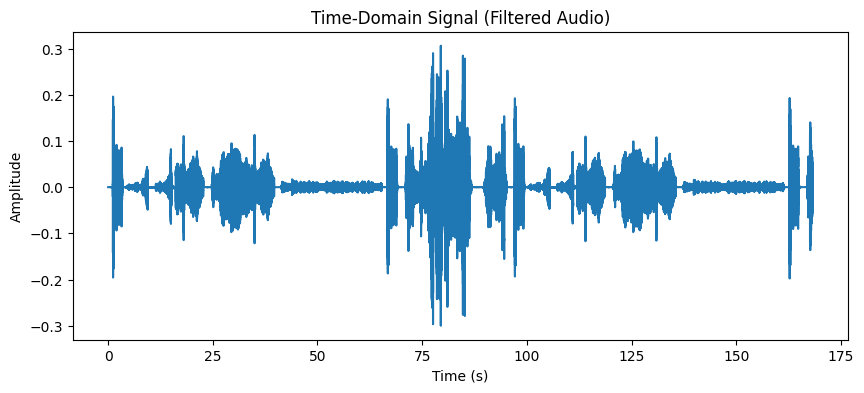

In [ ]:
# Plot the time-domain signal of the filtered audio
time_filtered = np.linspace(0, len(audio_filtered) / sample_rate, num=len(audio_filtered))
plt.figure(figsize=(10, 4))
plt.plot(time_filtered, audio_filtered)
plt.title("Time-Domain Signal (Filtered Audio)")
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.show()



```
Purpose:
Visualizes the amplitude of the audio over time.

Why np.linspace?
Creates evenly spaced time points for plotting.
```



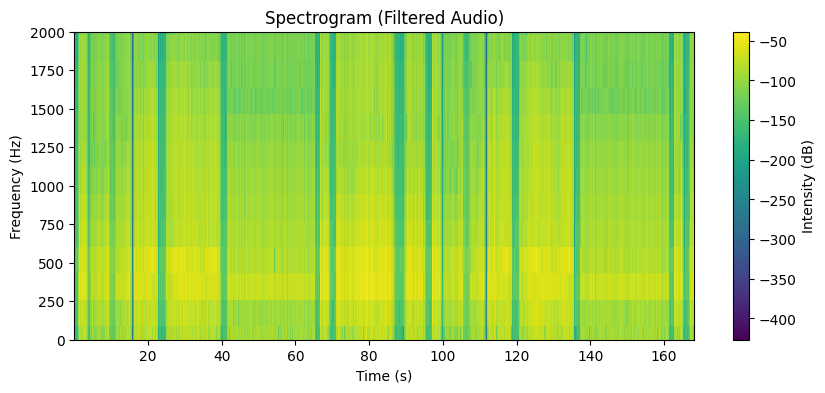

In [ ]:
# Compute the spectrogram
frequencies, times, Sxx = spectrogram(audio_filtered, sample_rate)
plt.figure(figsize=(10, 4))
plt.pcolormesh(times, frequencies, 10 * np.log10(Sxx))
plt.title("Spectrogram (Filtered Audio)")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")
plt.colorbar(label="Intensity (dB)")
plt.ylim(0, 2000)  # Limit to 2000 Hz for visualization
plt.show()



```
Purpose:
Displays how the signal's frequency content changes over time.

Why Limit to 2000 Hz?
The target frequency range for detecting dengue mosquito wingbeats is 300–600 Hz.
Limiting to 2000 Hz provides enough context to analyze these frequencies without visual clutter from irrelevant higher frequencies.

```



In [ ]:
# Perform FFT on the filtered audio
fft_result = np.fft.fft(audio_filtered)
fft_freq = np.fft.fftfreq(len(fft_result), 1/sample_rate)
fft_magnitude = np.abs(fft_result)



```
Purpose:
Uses the Fast Fourier Transform (FFT) to convert the audio signal from the time domain to the frequency domain.

Why Use FFT?
FFT calculates the frequencies present in the audio signal efficiently.
Formulas:
Frequency resolution:
Δf = sample_rate / length of audio

```



In [ ]:
# Filter positive frequencies
positive_freqs = fft_freq > 0
fft_freq = fft_freq[positive_freqs]
fft_magnitude = fft_magnitude[positive_freqs]



```
Purpose:
Removes negative frequencies (mirrored frequencies introduced by FFT).
```



In [ ]:
# Find the peak frequency
peaks, _ = find_peaks(fft_magnitude, height=0.1 * np.max(fft_magnitude))
dominant_freqs = fft_freq[peaks]
print(f"Dominant frequencies (Filtered): {dominant_freqs[:5]} Hz")  # Display top 5 dominant frequencies

Dominant frequencies (Filtered): [284.83585548 285.1983706  285.41825682 285.60248582 285.65597166] Hz




```
Purpose:
Identifies the most prominent frequencies using scipy.signal.find_peaks.

Why Use 0.1 * max?
Filters out low-amplitude noise by only considering peaks with significant height.
```



In [ ]:
# Check if the dominant frequency matches dengue-carrying mosquito range
if any(300 <= freq <= 600 for freq in dominant_freqs):
    print("Alert: Dengue mosquito species detected!")
else:
    print("No dengue mosquito species detected.")

Alert: Dengue mosquito species detected!




```
Purpose:
Checks if any of the dominant frequencies lie within the 300–600 Hz range, typical for dengue-carrying mosquito wingbeats.
```



**Summary:**

Load Audio- Reads audio files (WAV or MP3) and converts them to a NumPy array.
</br>
</br>
Preprocess Audio- Converts to mono, normalizes amplitude, and trims the first 4 seconds.
</br>
</br>
Analyze Audio-
*   Visualizes time-domain signals and spectrograms.
*   Extracts dominant frequencies using FFT.

</br>
Detect Mosquito- Matches dominant frequencies against the 300–600 Hz range.

# THE SYSTEM


In [ ]:
import numpy as np
from scipy.signal import find_peaks, butter, filtfilt
from scipy.io import wavfile
from pydub import AudioSegment
from IPython.display import Audio, display
from google.colab import files

# Band-pass filter function
def bandpass_filter(audio, lowcut, highcut, sample_rate, order=5):
    nyquist = 0.5 * sample_rate
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, audio)

# Function to load and preprocess audio
def load_audio(file_path):
    if file_path.endswith(".wav"):
        sample_rate, audio = wavfile.read(file_path)
    elif file_path.endswith(".mp3"):
        audio_mp3 = AudioSegment.from_mp3(file_path)
        audio = np.array(audio_mp3.get_array_of_samples())
        sample_rate = audio_mp3.frame_rate
        if audio_mp3.channels > 1:
            audio = audio.reshape(-1, audio_mp3.channels).mean(axis=1)  # Convert to mono
    else:
        raise ValueError("Unsupported file format. Please select WAV or MP3.")

    if len(audio.shape) > 1:
        audio = np.mean(audio, axis=1)  # Convert stereo to mono if needed

    # Normalize the audio
    if audio.dtype == np.int16:
        audio = audio / 32768.0
    elif audio.dtype == np.int32:
        audio = audio / 2147483648.0
    elif audio.dtype in [np.float32, np.float64]:
        audio = audio / np.max(np.abs(audio))

    return sample_rate, audio

# Function to detect dengue mosquito
def detect_mosquito(audio, sample_rate):
    # Apply band-pass filter for mosquito wingbeat frequencies (300-600 Hz)
    filtered_audio = bandpass_filter(audio, lowcut=300, highcut=600, sample_rate=sample_rate)

    # Perform FFT
    fft_result = np.fft.fft(filtered_audio)
    fft_freq = np.fft.fftfreq(len(fft_result), 1/sample_rate)
    fft_magnitude = np.abs(fft_result)

    # Filter positive frequencies
    positive_freqs = fft_freq > 0
    fft_freq = fft_freq[positive_freqs]
    fft_magnitude = fft_magnitude[positive_freqs]

    # Detect dominant frequencies
    peaks, _ = find_peaks(fft_magnitude, height=0.1 * np.max(fft_magnitude))
    dominant_freqs = fft_freq[peaks]

    print(f"Dominant frequencies: {dominant_freqs[:5]} Hz")

    # Check for mosquito frequency range (300-600 Hz)
    if any(300 <= freq <= 600 for freq in dominant_freqs):
        return True
    return False

# Main function for file upload and processing
def main():
    print("Please upload your audio file (WAV or MP3):")
    uploaded = files.upload()  # Upload file in Colab

    for file_name in uploaded.keys():
        print(f"Processing file: {file_name}")

        # Load and preprocess audio
        try:
            sample_rate, audio = load_audio(file_name)
        except Exception as e:
            print(f"Error loading audio: {e}")
            return

        # Play the uploaded audio
        print("Playing the audio...")
        display(Audio(data=audio, rate=sample_rate))

        # Detect mosquito frequencies
        is_mosquito = detect_mosquito(audio, sample_rate)
        if is_mosquito:
            print("Dengue mosquito detected!")
        else:
            print("No dengue mosquito detected.")

# Run the main function
if __name__ == "__main__":
    main()

Please upload your audio file (WAV or MP3):


Saving Bee Buzzing - Nature Sound Effects HD.wav to Bee Buzzing - Nature Sound Effects HD.wav
Processing file: Bee Buzzing - Nature Sound Effects HD.wav
Playing the audio...


Dominant frequencies: [285.60857599 286.78311435 287.07674893 288.44704368 289.71946023] Hz
Dengue mosquito detected!
